In [3]:
%load_ext autoreload
%autoreload 2
# this only works on startup!
from jax import config
config.update("jax_enable_x64", True)

import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID" 
os.environ["CUDA_VISIBLE_DEVICES"] = '0'
from encoding_information.gpu_utils import limit_gpu_memory_growth
limit_gpu_memory_growth()

from cleanplots import *
from tqdm import tqdm
from signal_utils_1D import *

sampling_indices = (3, 4)

## Generate many objects in parallel

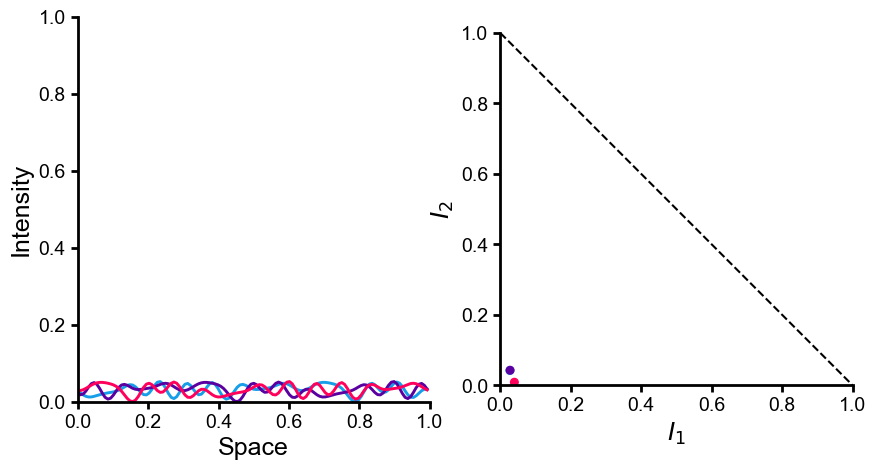

In [4]:
n_objects = 20
objects = np.array([sample_amplitude_object('delta') for i in range(n_objects)])

# generate random convolution kernel
random_kernel = bandlimited_nonnegative_signal(nyquist_samples=generate_random_bandlimited_signal())
conv_mat = make_convolutional_encoder(random_kernel)

output_signals = objects @ conv_mat.T 


sampling_indices = (3, 4)
num_to_plot = 3

fig, ax = plt.subplots(1, 2, figsize=(10, 5))
plot_in_spatial_coordinates(ax[0], output_signals[:num_to_plot], sample_point_indices=sampling_indices)
plot_in_intensity_coordinates(ax[1], output_signals[:num_to_plot], sample_point_indices=sampling_indices, differentiate_colors=True)

## Show example objects

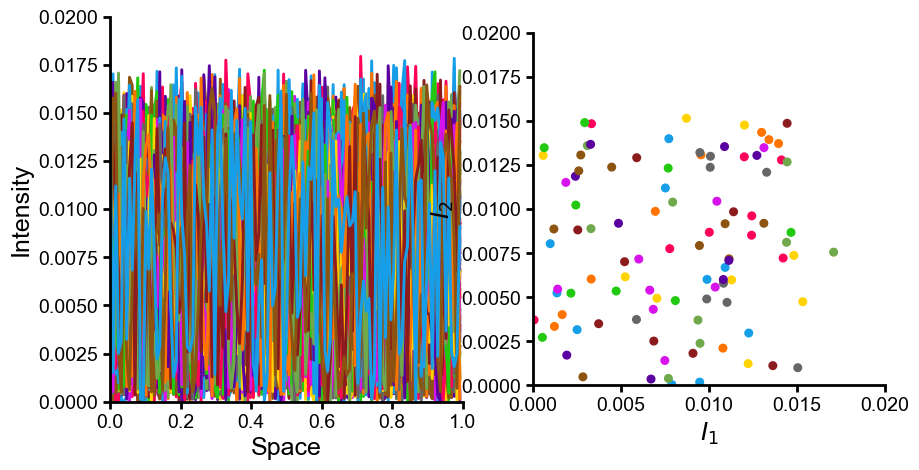

In [3]:
n_objects = 100
objects = np.array([sample_amplitude_object('white_noise', gaussian_mixture_position=True) for i in range(n_objects)])
# objects = np.array([sample_amplitude_object('sinusoid', sin_freq_range=(9, 10)) for i in range(n_objects)])

# plot all the objects
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
plot_in_spatial_coordinates(ax[0], objects, sample_point_indices=sampling_indices, plot_lim=0.02)
plot_in_intensity_coordinates(ax[1], objects, sample_point_indices=sampling_indices, differentiate_colors=True, plot_lim=0.02)



## See if randomly masking before convolving increases entropy (without optimization)

In [15]:
N_objects = 1000
N_display_objects = 4

objects = np.array([sample_amplitude_object('white_noise') for i in range(N_objects)])

object_sampling_indices = np.array(sampling_indices) * (OBJECT_LENGTH // NUM_NYQUIST_SAMPLES)
renormalized_objects = objects * (OBJECT_LENGTH / NUM_NYQUIST_SAMPLES)   

kernel = generate_concentrated_signal((NUM_NYQUIST_SAMPLES // 2, NUM_NYQUIST_SAMPLES // 2 + 1))
params = np.concatenate(real_imag_params_from_signal(kernel))



Non-masked entropy: -4.7535574695269975
Masked entropy: -4.7535574695269975


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.717729336105236


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.715404702140423


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.69738381974812


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.682742529019939


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.643266319065648


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.599054515848508


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.598415547601396


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.558486392235499


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.540516134011427




/tmp/ipykernel_10751/3134877686.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 3, figsize=(15, 10))


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.520907361520768


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.442304383549767


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.4668370378405715


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.420422680289458


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.368765985789092


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.393047638159557


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.57663000915689


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.954167734334306


Non-masked entropy: -4.7535574695269975
Masked entropy: -3.370877246461334


Non-masked entropy: -4.7535574695269975
Masked entropy: -4.524357495788991


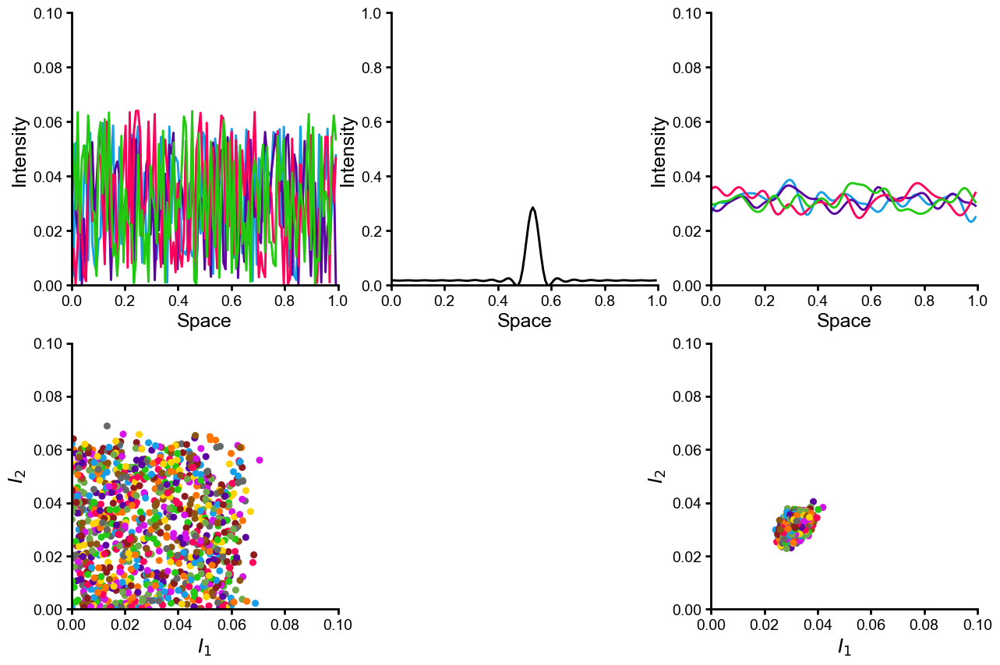

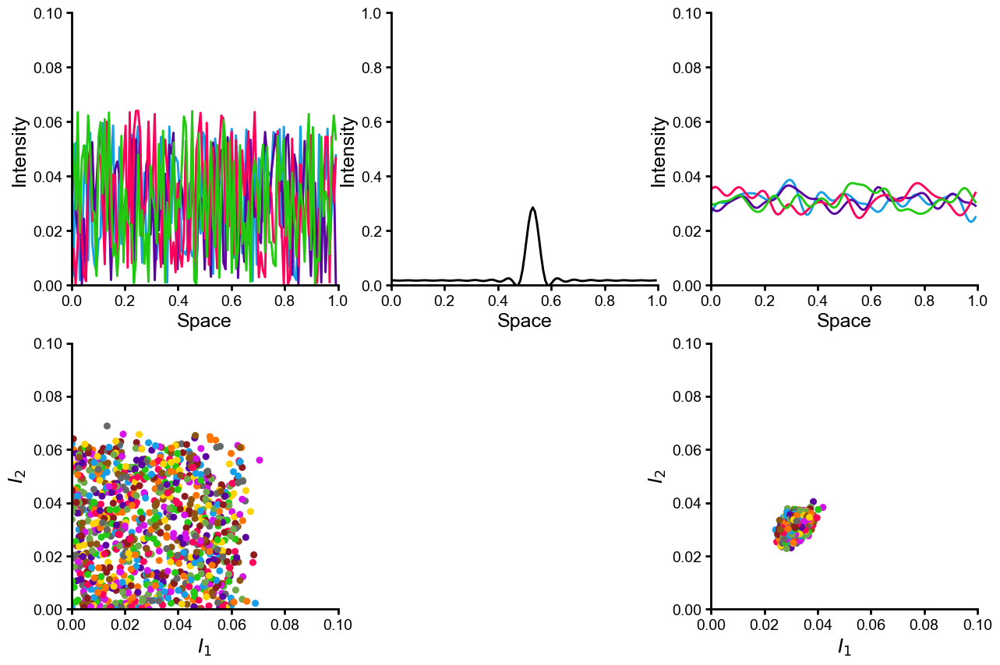

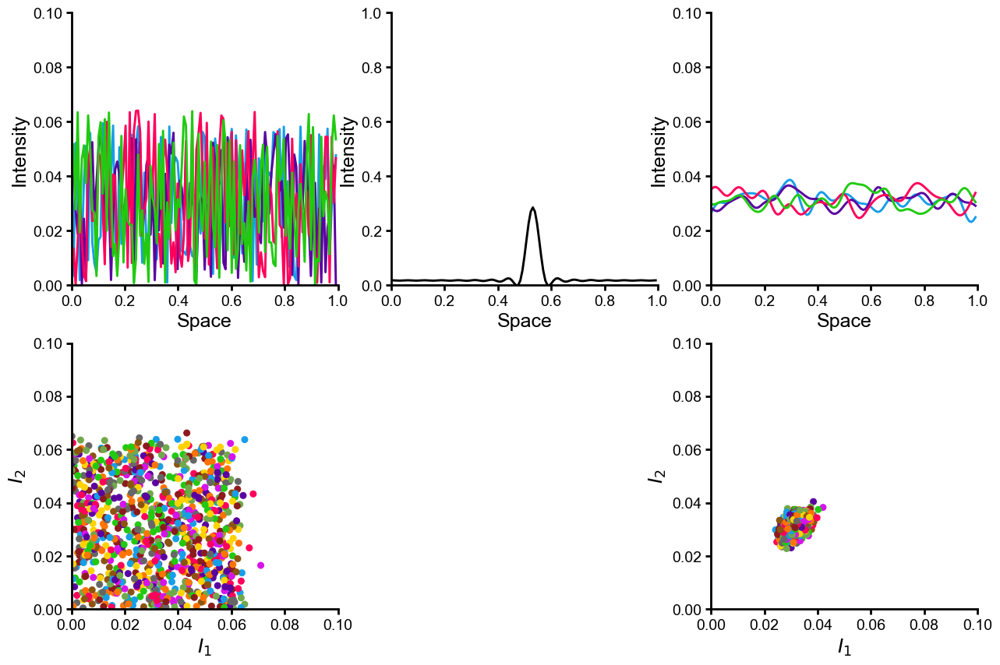

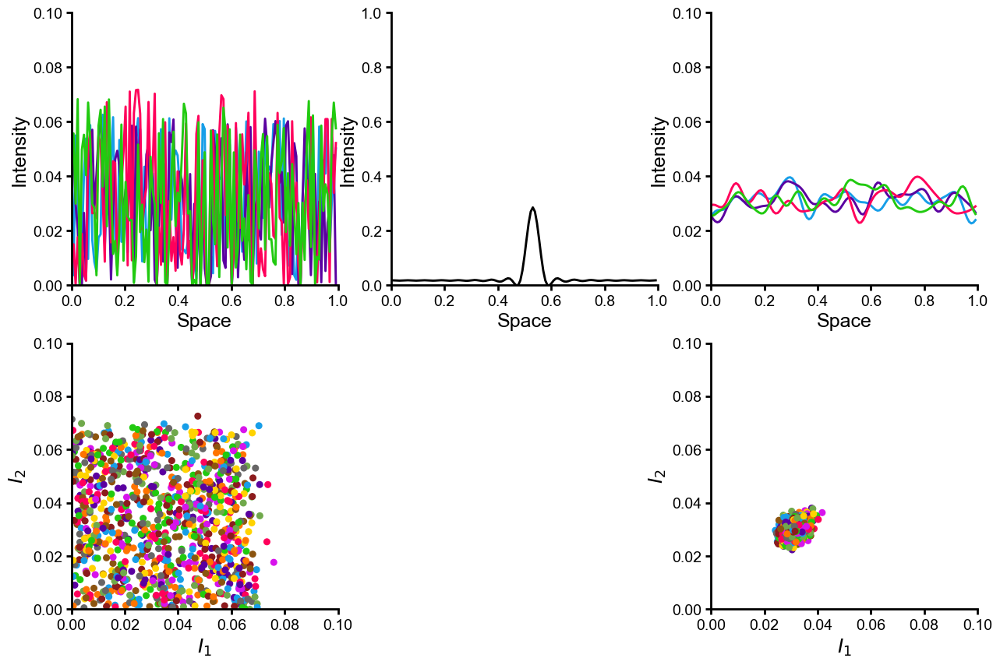

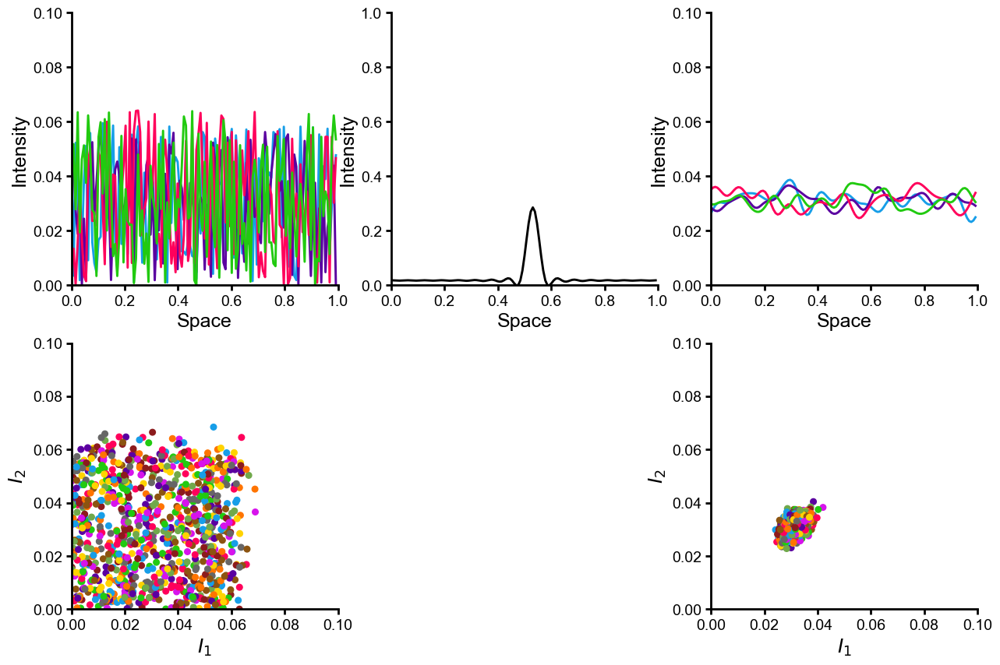

...

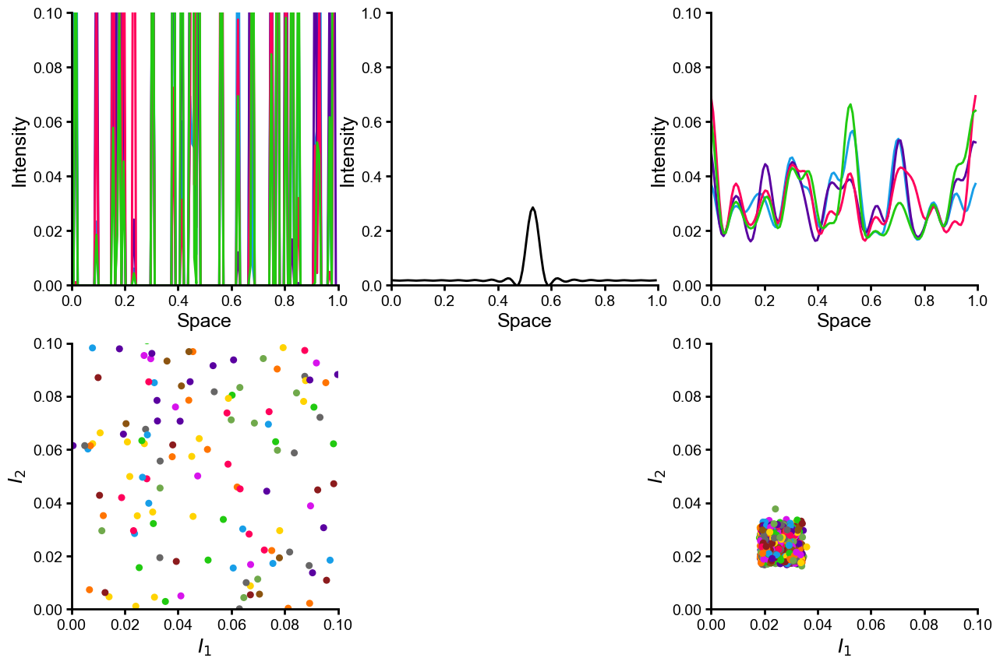

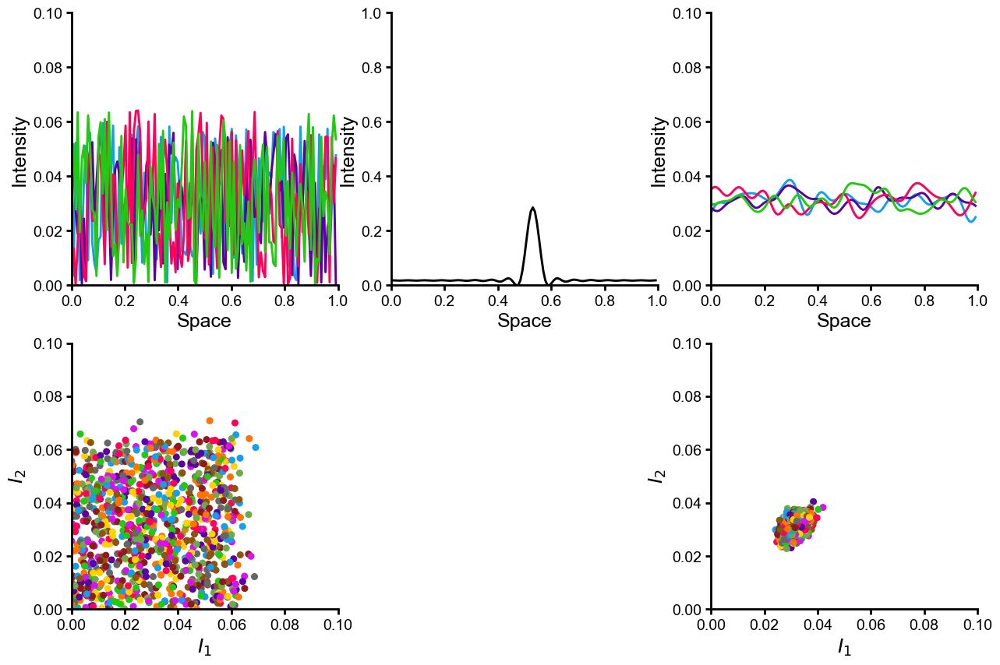

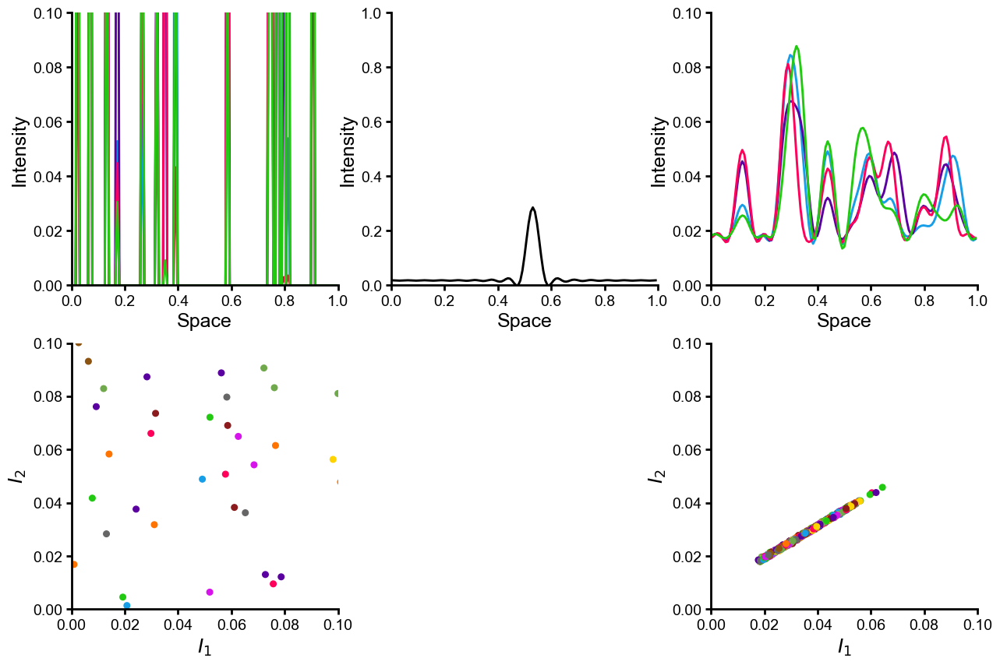

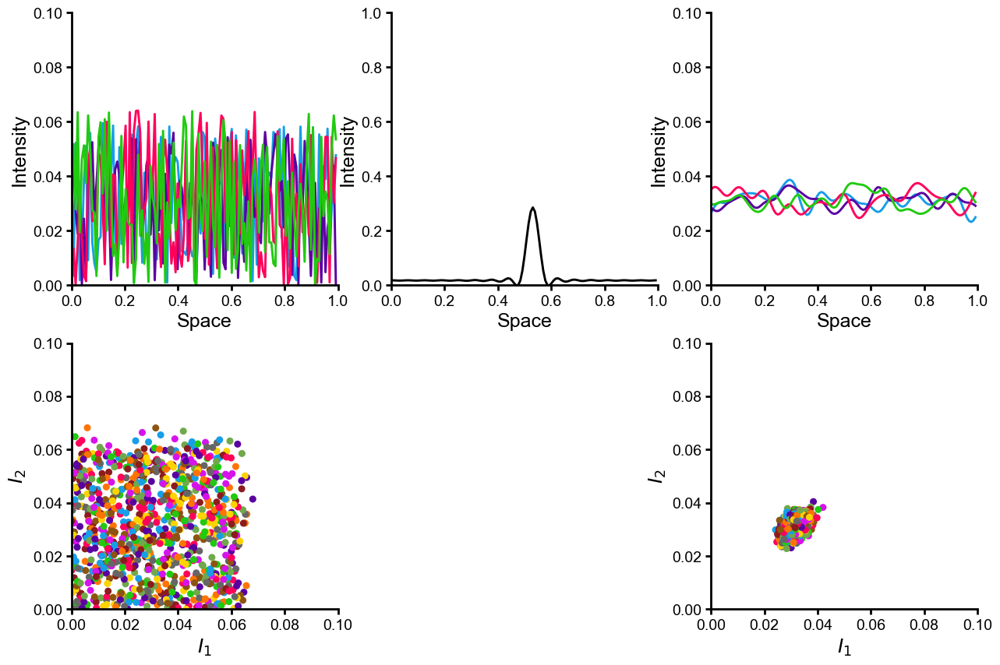

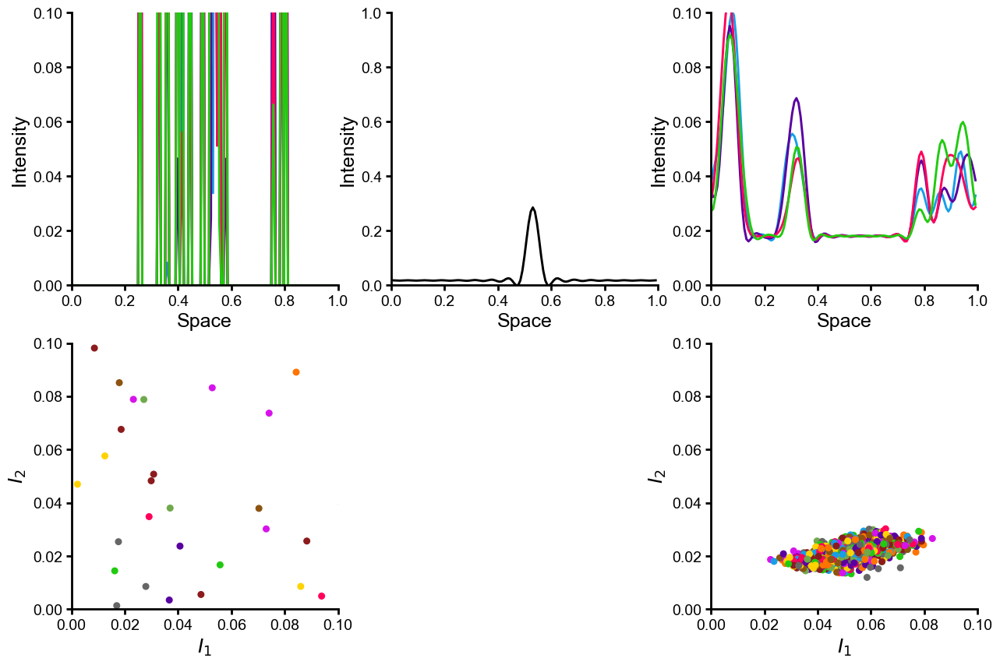

In [6]:

renormalize = True # renomralize the objects to have the same total energy before and after masking

for percent_masked in np.linspace(0, 0.9, 20):
    print('\n')
    
    # percent_masked = 0.2

    signals = conv_forward_model(params, objects)


    # generate a random mask the same size as the objects
    mask = onp.random.rand(objects.shape[1]) >  percent_masked
    masked_objects = objects * mask.astype(float)
    # renormalize the objects
    if renormalize:
        masked_objects = masked_objects / np.sum(masked_objects, axis=1, keepdims=True)
    # account for the loss of energy due to sampling
    renormalized_masked_objects = masked_objects * (OBJECT_LENGTH / NUM_NYQUIST_SAMPLES)

    masked_signals = conv_forward_model(params, masked_objects)


    # get object sampling indices that aren't masked by choosing from the mask
    object_sampling_indices = onp.random.choice(np.where(mask)[0], size=2, replace=False)



    # plot objects, kernel, and initial signals
    fig, ax = plt.subplots(2, 3, figsize=(15, 10))
    plot_in_spatial_coordinates(ax[0,0], renormalized_objects[:N_display_objects], sample_point_indices=object_sampling_indices, plot_lim=0.1)
    plot_in_spatial_coordinates(ax[0,1], kernel, sample_point_indices=sampling_indices)
    plot_in_spatial_coordinates(ax[0,2], signals[:N_display_objects], sample_point_indices=sampling_indices, plot_lim=.1)
    # show intensity coordinates
    plot_in_intensity_coordinates(ax[1,0], renormalized_objects, sample_point_indices=object_sampling_indices, differentiate_colors=True, plot_lim=0.1)
    # turn off
    ax[1,1].axis('off')
    plot_in_intensity_coordinates(ax[1,2], signals, sample_point_indices=sampling_indices, differentiate_colors=True, plot_lim=.1)

    non_masked_entropy = compute_gaussian_differential_entropy_per_pixel(signals)





    # plot objects, kernel, and initial signals
    fig, ax = plt.subplots(2, 3, figsize=(15, 10))
    plot_in_spatial_coordinates(ax[0,0], renormalized_masked_objects[:N_display_objects], sample_point_indices=object_sampling_indices, plot_lim=0.1)
    plot_in_spatial_coordinates(ax[0,1], kernel, sample_point_indices=sampling_indices)
    plot_in_spatial_coordinates(ax[0,2], masked_signals[:N_display_objects], sample_point_indices=sampling_indices, plot_lim=.1)
    # show intensity coordinates
    plot_in_intensity_coordinates(ax[1,0], renormalized_masked_objects, sample_point_indices=object_sampling_indices, differentiate_colors=True, plot_lim=0.1)
    # turn off
    ax[1,1].axis('off')
    plot_in_intensity_coordinates(ax[1,2], masked_signals, sample_point_indices=sampling_indices, differentiate_colors=True, plot_lim=.1)


    masked_entropy = compute_gaussian_differential_entropy_per_pixel(masked_signals)

    print(f'Non-masked entropy: {non_masked_entropy}')
    print(f'Masked entropy: {masked_entropy}')

## Try a different object

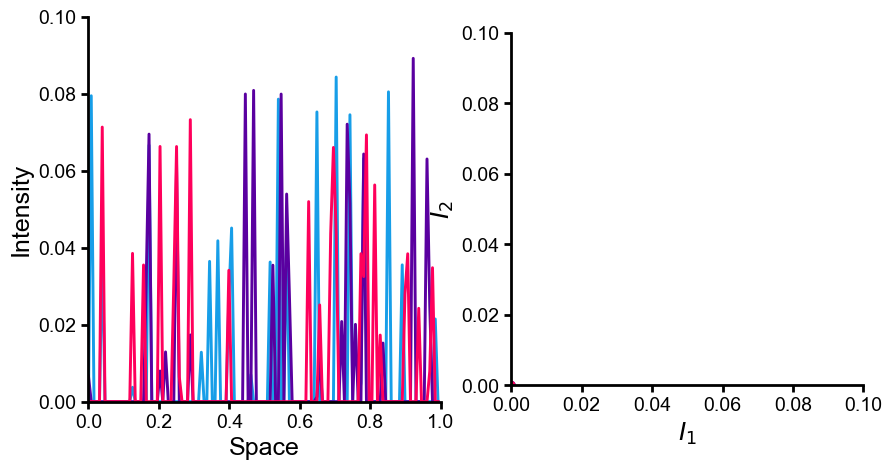

In [16]:
n_objects = 3
objects = np.array([sample_amplitude_object('masked_white_noise', gaussian_mixture_position=True) for i in range(n_objects)])
# objects = np.array([sample_amplitude_object('sinusoid', sin_freq_range=(9, 10)) for i in range(n_objects)])

# plot all the objects
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
plot_in_spatial_coordinates(ax[0], objects, sample_point_indices=sampling_indices, plot_lim=0.1)
plot_in_intensity_coordinates(ax[1], objects, sample_point_indices=sampling_indices, differentiate_colors=True, plot_lim=0.1)



In [19]:
N_objects = 1000
N_display_objects = 4

objects = np.array([sample_amplitude_object('masked_white_noise') for i in range(N_objects)])

object_sampling_indices = np.array(sampling_indices) * (OBJECT_LENGTH // NUM_NYQUIST_SAMPLES)
renormalized_objects = objects * (OBJECT_LENGTH / NUM_NYQUIST_SAMPLES)   

kernel = generate_concentrated_signal((NUM_NYQUIST_SAMPLES // 2, NUM_NYQUIST_SAMPLES // 2 + 1))
params = np.concatenate(real_imag_params_from_signal(kernel))



Non-masked entropy: -3.3266853466839406
Masked entropy: -3.3266853466839406


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.3559505007787815


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.3960415836402573


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.395731527818172


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.4280505149677687


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.477076307020646


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.480695301612657


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.488084303797871


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.609623722631826


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.7157777310539606




/tmp/ipykernel_20080/254763323.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 3, figsize=(15, 10))


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.6448956526127976


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.6402401542965337


Non-masked entropy: -3.3266853466839406
Masked entropy: -3.759994551293997


Non-masked entropy: -3.3266853466839406
Masked entropy: -4.035535949305845


Non-masked entropy: -3.3266853466839406
Masked entropy: -4.493754579993551


Non-masked entropy: -3.3266853466839406
Masked entropy: -4.036481574140596


Non-masked entropy: -3.3266853466839406
Masked entropy: -4.162085880680406


Non-masked entropy: -3.3266853466839406
Masked entropy: -4.282051590728761


Non-masked entropy: -3.3266853466839406
Masked entropy: -4.257086471159152


Non-masked entropy: -3.3266853466839406
Masked entropy: -4.49552303323224


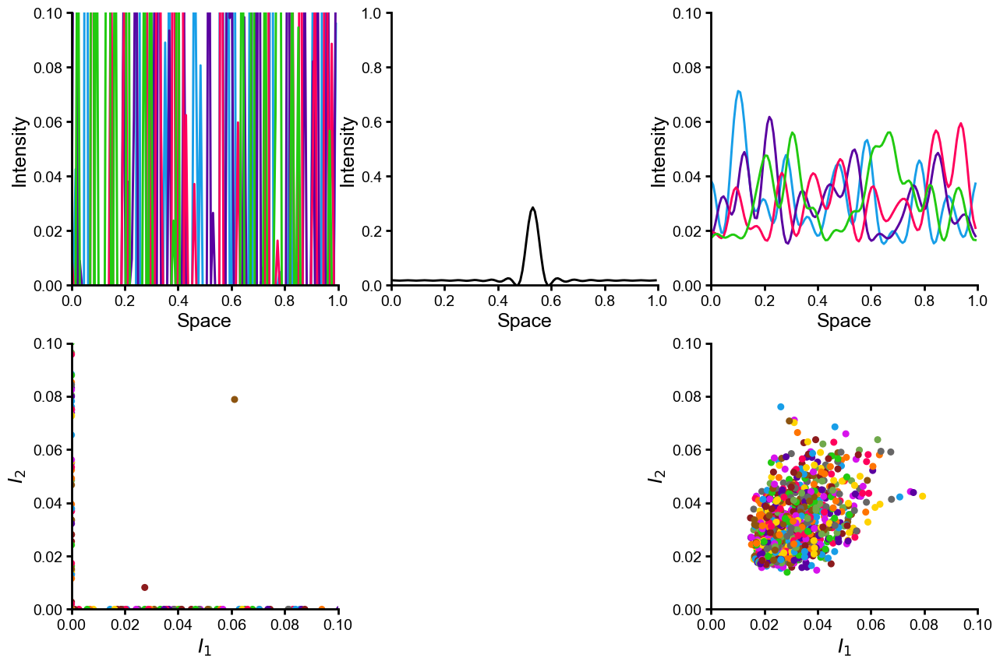

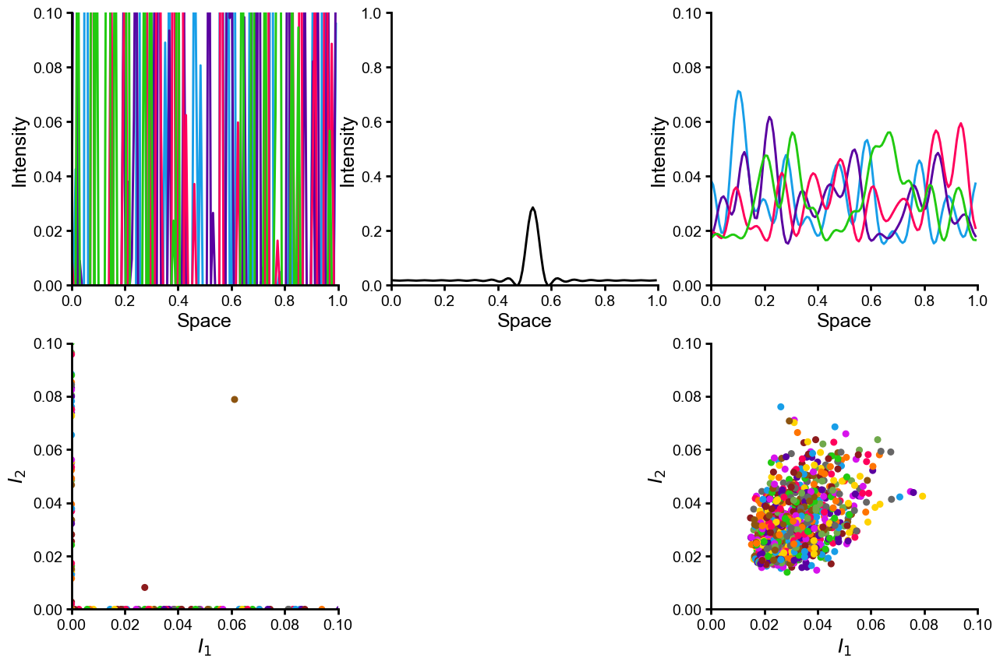

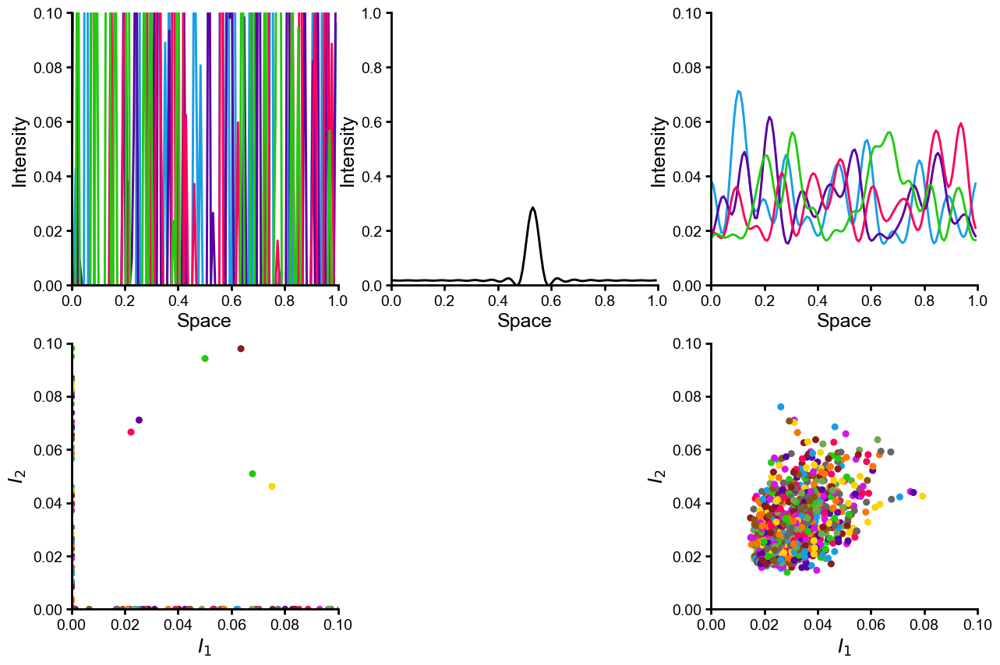

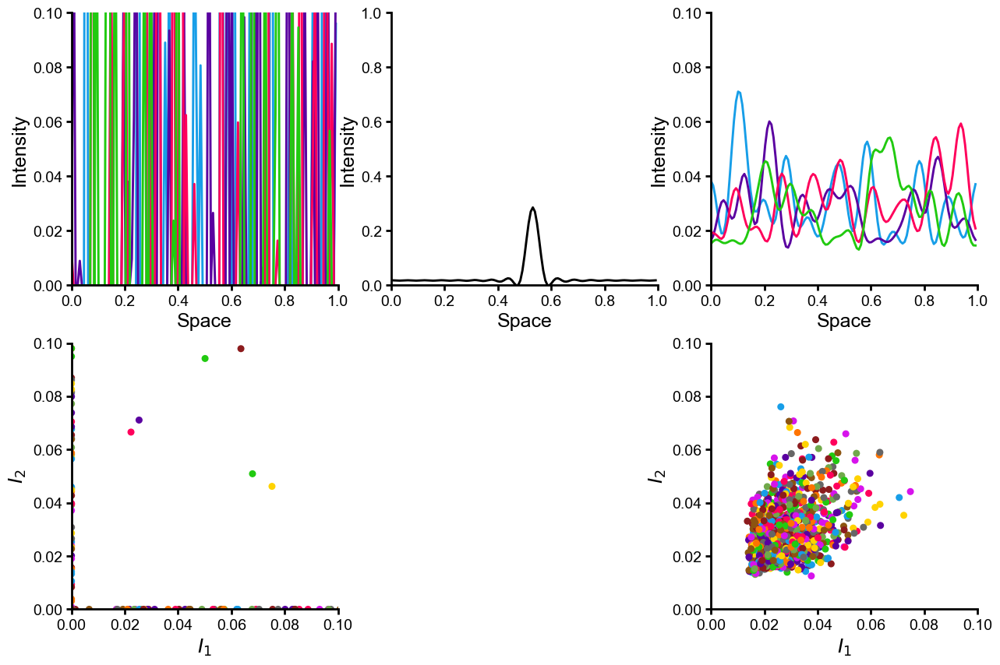

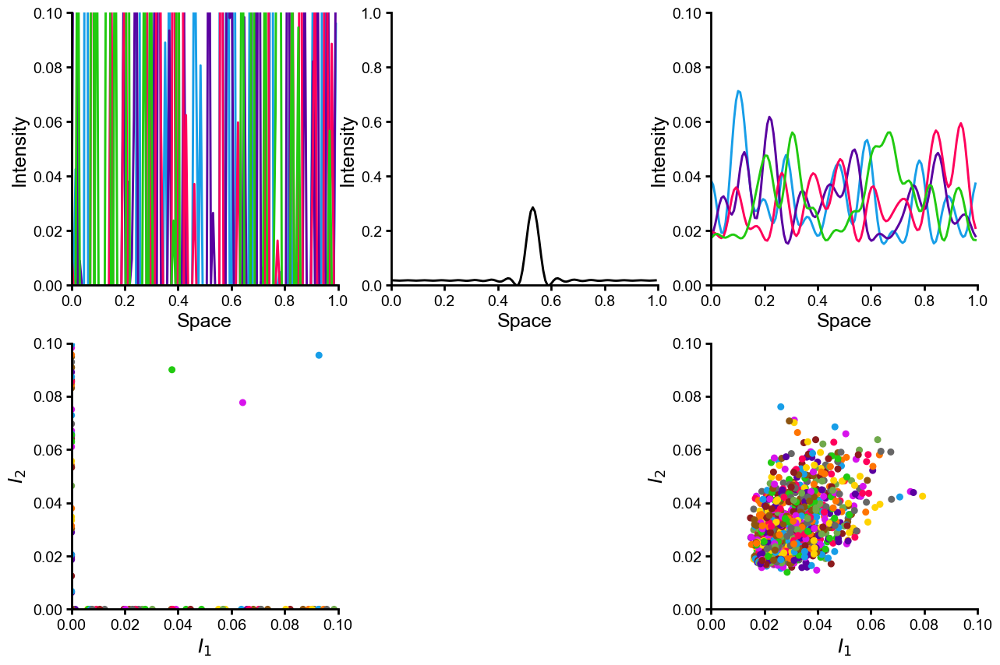

...

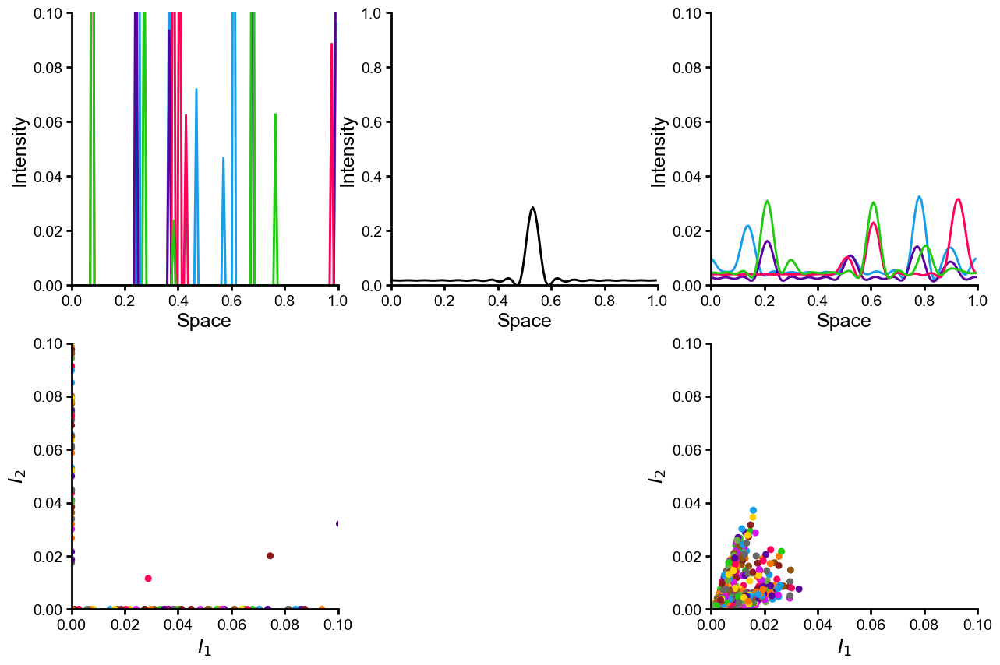

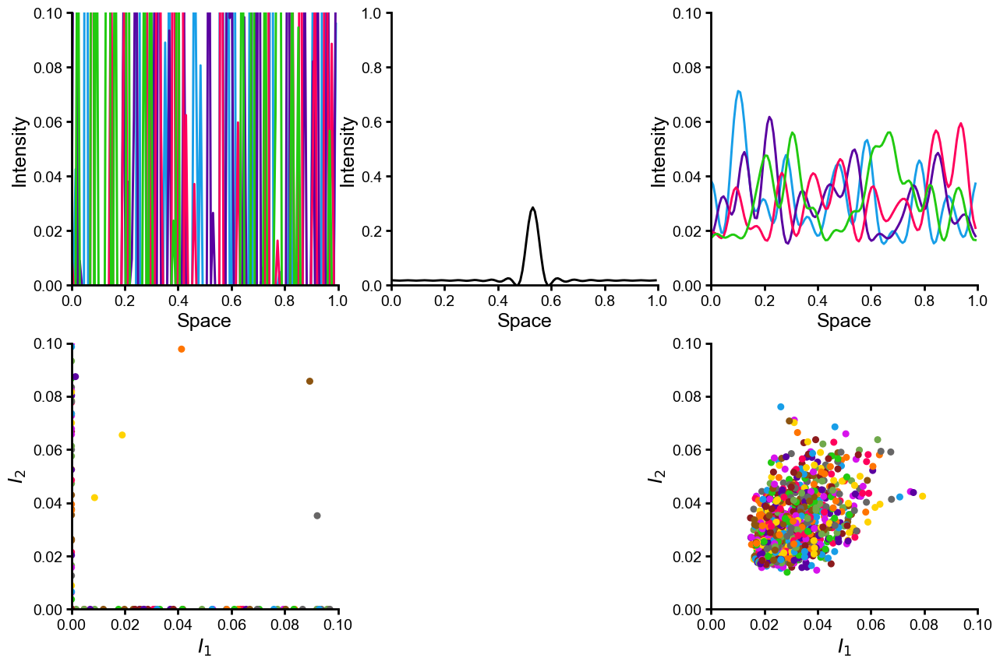

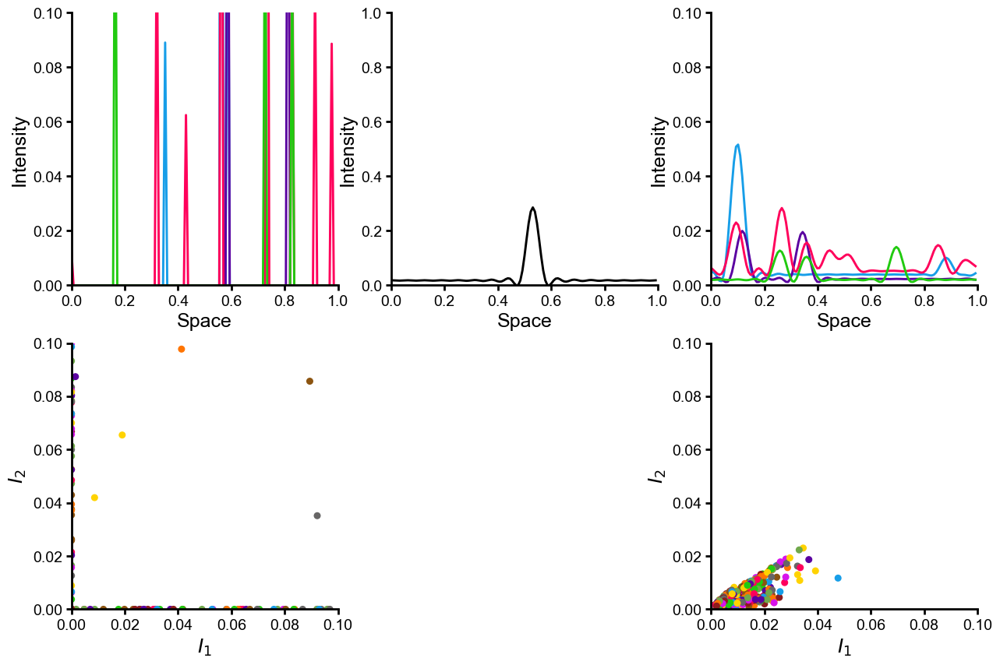

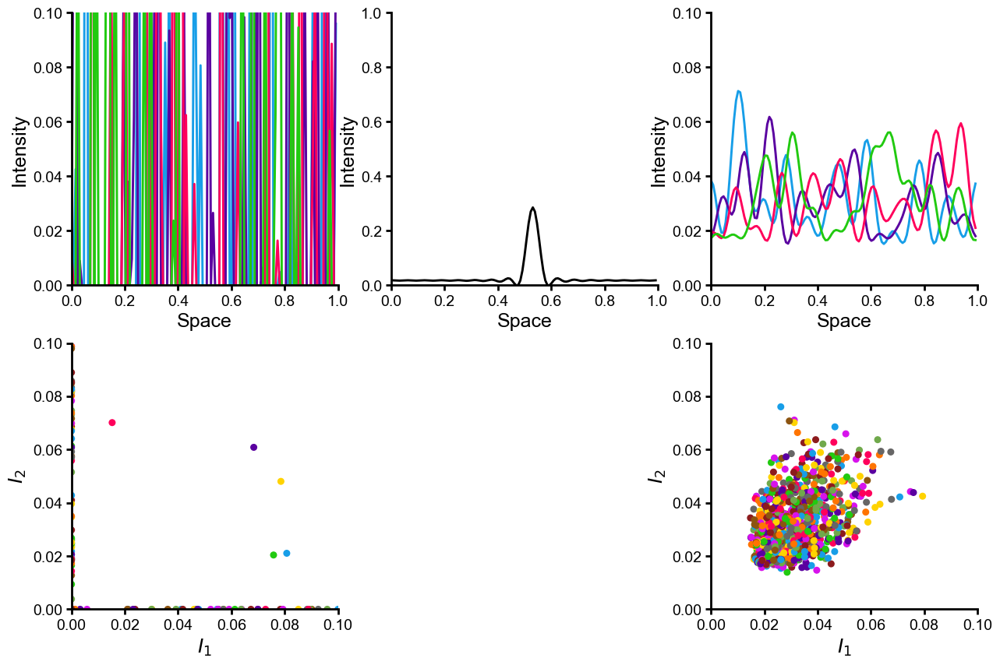

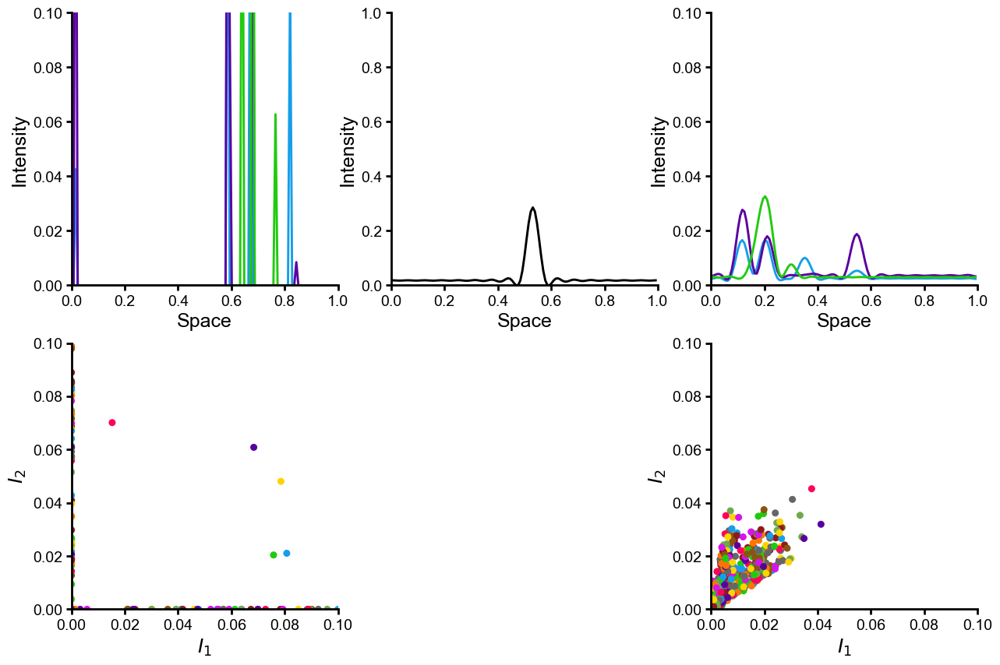

In [20]:

renormalize = False # renomralize the objects to have the same total energy before and after masking

for percent_masked in np.linspace(0, 0.9, 20):
    print('\n')
    
    signals = conv_forward_model(params, objects)

    # generate a random mask the same size as the objects
    mask = onp.random.rand(objects.shape[1]) >  percent_masked
    masked_objects = objects * mask.astype(float)
    # renormalize the objects
    if renormalize:
        masked_objects = masked_objects / np.sum(masked_objects, axis=1, keepdims=True)
    # account for the loss of energy due to sampling
    renormalized_masked_objects = masked_objects * (OBJECT_LENGTH / NUM_NYQUIST_SAMPLES)

    masked_signals = conv_forward_model(params, masked_objects)


    # get object sampling indices that aren't masked by choosing from the mask
    object_sampling_indices = onp.random.choice(np.where(mask)[0], size=2, replace=False)



    # plot objects, kernel, and initial signals
    fig, ax = plt.subplots(2, 3, figsize=(15, 10))
    plot_in_spatial_coordinates(ax[0,0], renormalized_objects[:N_display_objects], sample_point_indices=object_sampling_indices, plot_lim=0.1)
    plot_in_spatial_coordinates(ax[0,1], kernel, sample_point_indices=sampling_indices)
    plot_in_spatial_coordinates(ax[0,2], signals[:N_display_objects], sample_point_indices=sampling_indices, plot_lim=.1)
    # show intensity coordinates
    plot_in_intensity_coordinates(ax[1,0], renormalized_objects, sample_point_indices=object_sampling_indices, differentiate_colors=True, plot_lim=0.1)
    # turn off
    ax[1,1].axis('off')
    plot_in_intensity_coordinates(ax[1,2], signals, sample_point_indices=sampling_indices, differentiate_colors=True, plot_lim=.1)

    non_masked_entropy = compute_gaussian_differential_entropy_per_pixel(signals)





    # plot objects, kernel, and initial signals
    fig, ax = plt.subplots(2, 3, figsize=(15, 10))
    plot_in_spatial_coordinates(ax[0,0], renormalized_masked_objects[:N_display_objects], sample_point_indices=object_sampling_indices, plot_lim=0.1)
    plot_in_spatial_coordinates(ax[0,1], kernel, sample_point_indices=sampling_indices)
    plot_in_spatial_coordinates(ax[0,2], masked_signals[:N_display_objects], sample_point_indices=sampling_indices, plot_lim=.1)
    # show intensity coordinates
    plot_in_intensity_coordinates(ax[1,0], renormalized_masked_objects, sample_point_indices=object_sampling_indices, differentiate_colors=True, plot_lim=0.1)
    # turn off
    ax[1,1].axis('off')
    plot_in_intensity_coordinates(ax[1,2], masked_signals, sample_point_indices=sampling_indices, differentiate_colors=True, plot_lim=.1)


    masked_entropy = compute_gaussian_differential_entropy_per_pixel(masked_signals)

    print(f'Non-masked entropy: {non_masked_entropy}')
    print(f'Masked entropy: {masked_entropy}')